<a href="https://colab.research.google.com/github/sameer0013/Mask-Detection/blob/main/mask_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MASK DETECTION USING YOLOV5
  During the time of covid it is neccessary for all to wear mask as that time mask is one of  the major precautioned that everyone should take. so detect whether a person wears a mask or not i made a deep leanring based mask detection model.

  
  mask detection refers to detect whether a person is wearing a mask or not using yolov5.YOLO is a version of Fully Convolutional Networks that have been used to detect objects in real-time for years.

    ● YOLO stands for "You Only Look Once." Yolo is named from the fact that it only takes one forward propagation across a neural network to detect things. 
    ● This is understandable because Yolo predicts the entire image in a single algorithm run.
    ● Yolo is a regression approach that delivers the discovered images' class probabilities.

  In below code i used yolo version 5 as Yolo v5 uses CSPNet as its backbone to extract rich information and also it based on pytorch.  

1> first i check what GPU is provided by Google colab as
the deep neural networks are specifically made for running in parallel. Since they are the base for deep learning, we can conclude that GPUs are perfect for this task. Additionally, neural networks are parallel in such a way that they do not have to depend on each other's results and yes GPU is also 3x faster than CPU

In [ ]:
!nvidia-smi

Fri Jul 15 03:52:52 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

2> Now as i use yolov5 for model building , I have to clone its repositary from github to my colab notebook and  all the information about yoloV5 is mentioned there for more details follow this [link]( https://github.com/ultralytics/yolov5.git)

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 12580, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 12580 (delta 1), reused 4 (delta 1), pack-reused 12575
Receiving objects: 100% (12580/12580), 12.26 MiB | 27.42 MiB/s, done.
Resolving deltas: 100% (8657/8657), done.


3> Now after successfull clonnig of  github repositary the another step is of installing  all the requirements which are necessary for yolov5

In [ ]:
%cd yolov5/
!pip install -r requirements.txt

/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 7.4 MB/s 
     |████████████████████████████████| 750.6 MB 11 kB/s 
     |████████████████████████████████| 21.0 MB 1.4 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.12.0+cu113
    Uninstalling torch-1.12.0+cu113:
      Successfully uninstalled torch-1.12.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.13.0+cu113
    Uninstalling torchvision-0.13.0+cu113:
      Successfully uninstalled torchvision-0.13.0+cu113
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.13.0 requires 

#Dataset for mask detection 
 
 for trainning any object detection model you must have a proper image dataset with their respective  .txt file with the same name is created for each image file in the same directory which contains annotations and a numeric representation of the label and a labelmap which maps the numeric IDs to human readable strings.



# If you have random dataset you can follow below steps for uploading dataset inside colab files.

##1)mkdir custom dataset on "content/yolov5/data"
##2)on that directory create folder "train" where training images and labels are then uploaded
##3)make separae folders for images and labels inside "train" folder

##4)then create a dataset.yaml file on content/yolov5
##5) dataset.yaml file has data in below format 
    train: ./data/custom dataset/train/images #training images path

    val: ./data/custom dataset/train/images # validation images path

    nc: 1  # number of classes

    names: ['mask'] # class names 

4> now as i take dataset for training my model from roboflow  i have to fetch it from roboflow so below is the code for fetching data from roboflow


you can check dataset from [here](https://app.roboflow.com/college-qyxyp/mask-wearing-sbqrh/6)


In [ ]:
%pip install -q roboflow

     |████████████████████████████████| 145 kB 7.9 MB/s 
     |████████████████████████████████| 178 kB 61.2 MB/s 
     |████████████████████████████████| 3.1 MB 65.5 MB/s 
     |████████████████████████████████| 1.1 MB 61.9 MB/s 
     |████████████████████████████████| 21.8 MB 21.3 MB/s 
     |████████████████████████████████| 67 kB 7.6 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 138 kB 73.5 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.13.0 requires torch==1.12.0, but you have torch 1.11.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.28.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 require

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="HV3FFKqqhVYjj6FRTfqq")
project = rf.workspace("college-qyxyp").project("mask-wearing-sbqrh")
dataset = project.version(6).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Mask-Wearing-6 in yolov5pytorch:: 100%|██████████| 3475/3475 [00:03<00:00, 876.70it/s] 


In [ ]:
dataset.location

'/content/yolov5/Mask-Wearing-6'

5> Now setup GPU first before taking any other step.

In [ ]:
import torch 
import os
from IPython.display import Image, clear_output
print(f"Setup complete. Using torch{torch.__version__}({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch1.11.0+cu102(Tesla T4)


6> Its time for model building , i run below code for model building on 50 epochs you can give as many epochs as many you want 

In [ ]:
! python train.py --img 600  --batch 8 --data {dataset.location}/data.yaml --epochs 50 --weight 'yolov5s.pt' --cache

train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Mask-Wearing-6/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=8, imgsz=600, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-295-gf8722b4 Python-3.7.13 torch-1.11.0+cu102 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.

#Trainning Result
  these are those images  which i used for training mask detection model    

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

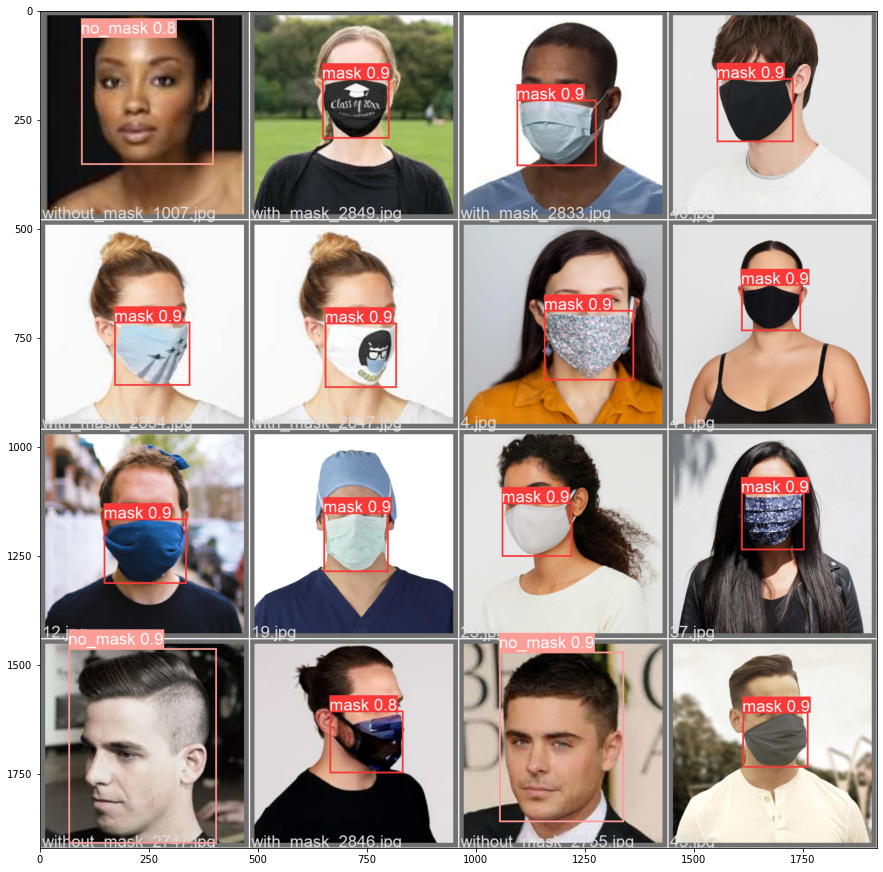

In [ ]:
plt.figure(figsize=(15,20))
img = Image.open("/content/yolov5/runs/train/exp/val_batch2_pred.jpg")
plt.imshow(img)
plt.show()

#Model Testing



In [ ]:
! python detect.py --source "/content/test.jpg" --weights "/content/yolov5/runs/train/exp/weights/best.pt"

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/test.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-295-gf8722b4 Python-3.7.13 torch-1.11.0+cu102 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/test.jpg: 640x640 1 mask, Done. (0.014s)
Speed: 0.6ms pre-process, 14.1ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


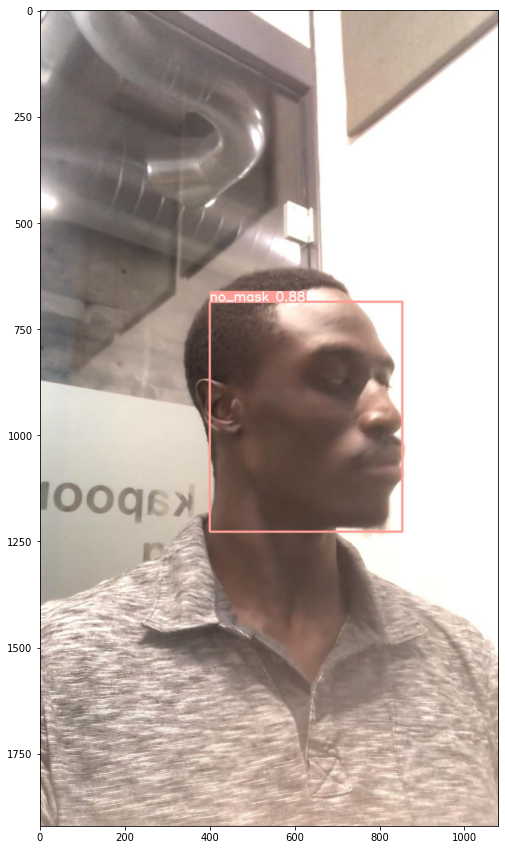

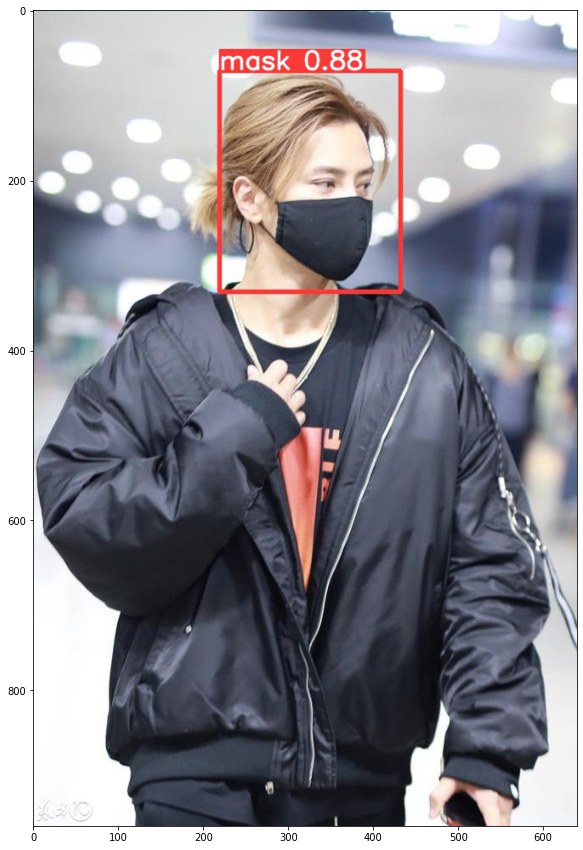

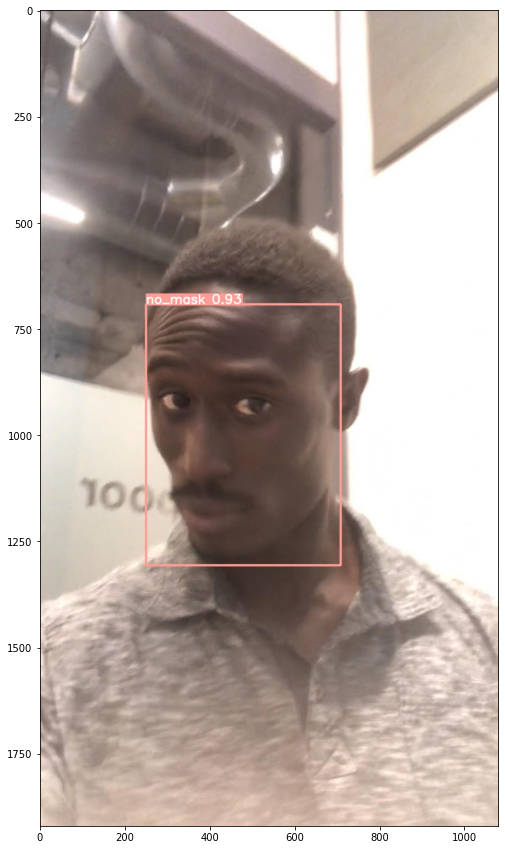

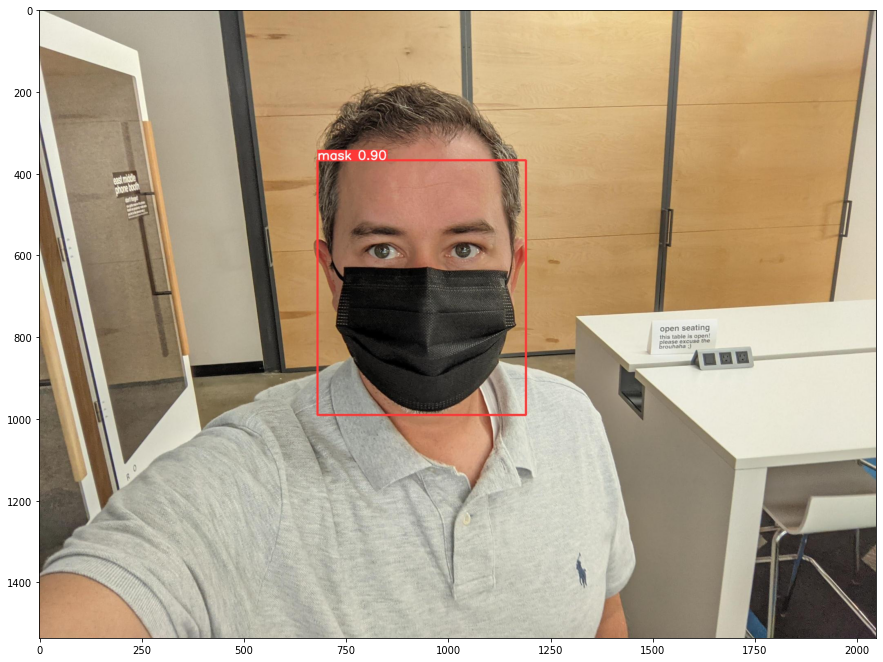

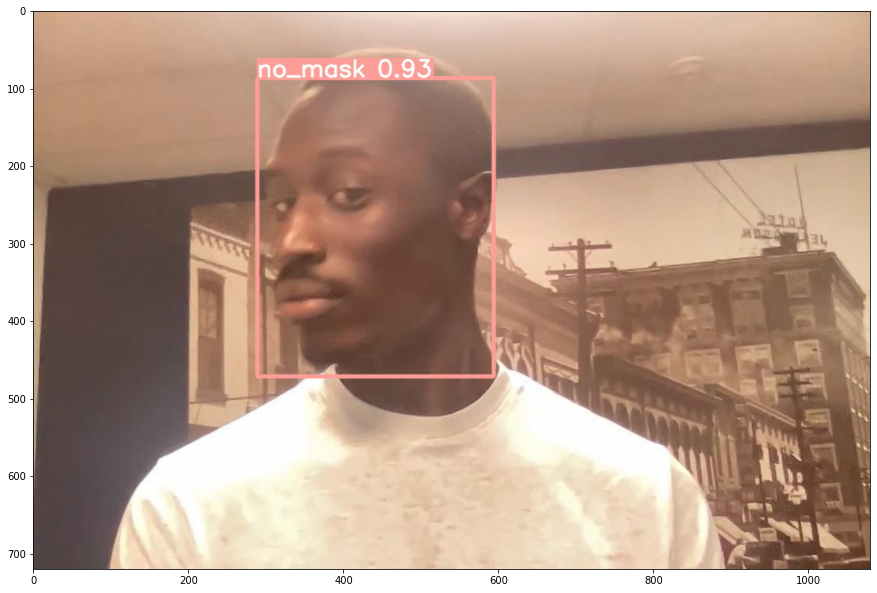

...

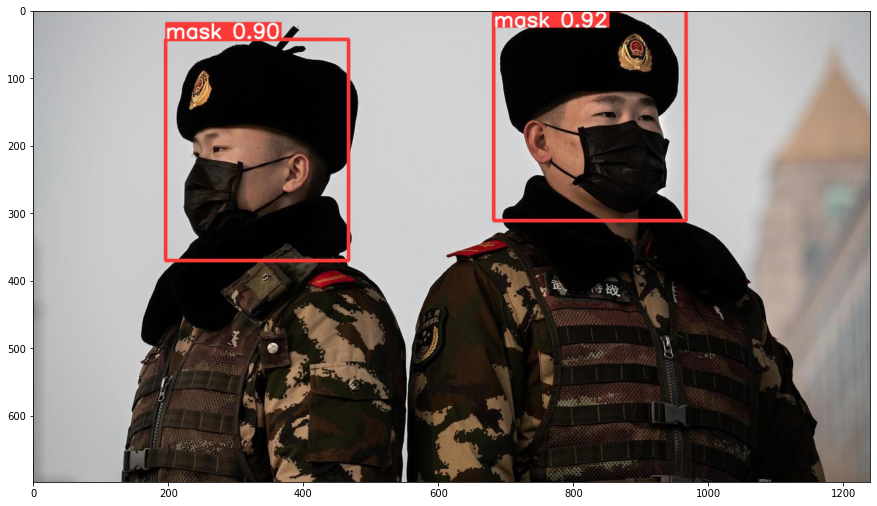

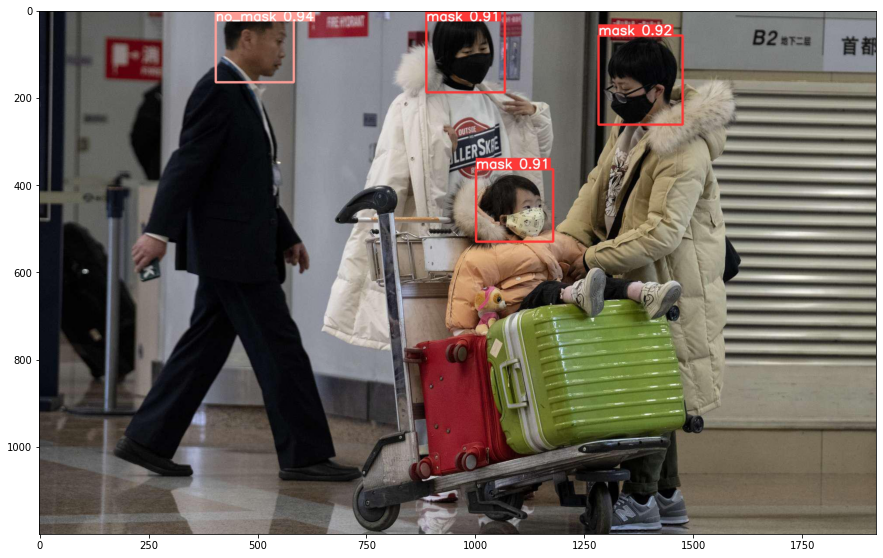

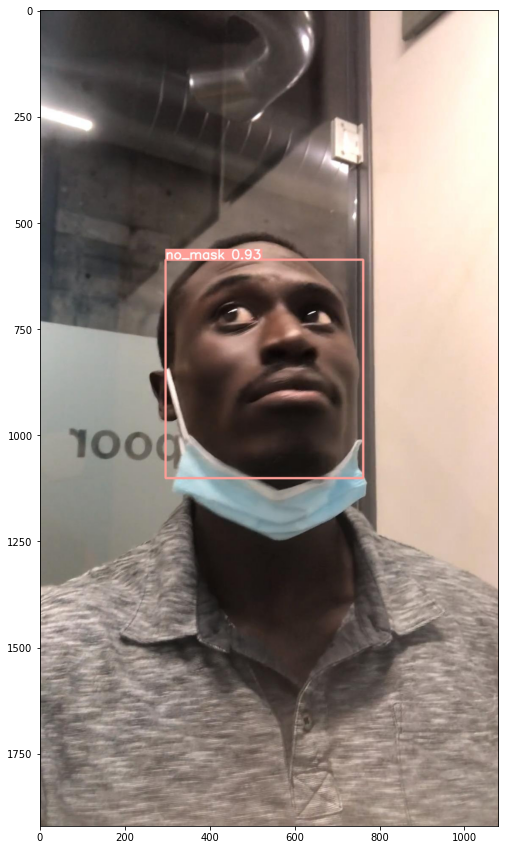

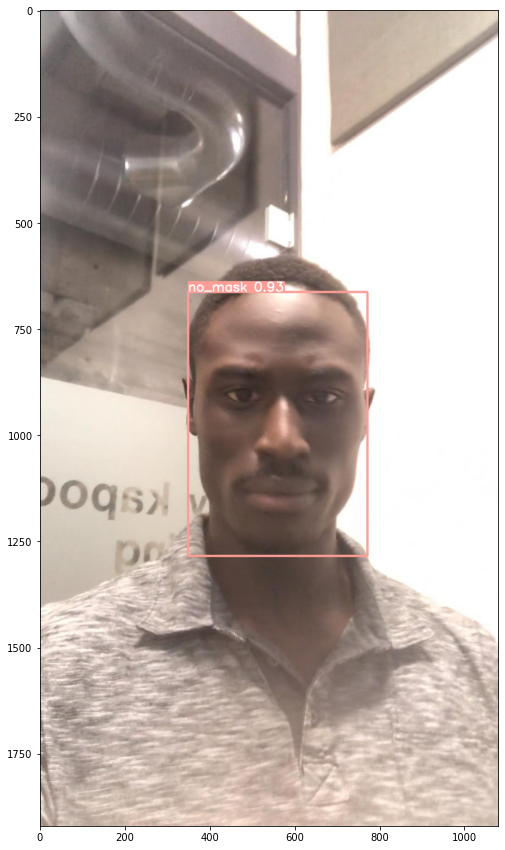

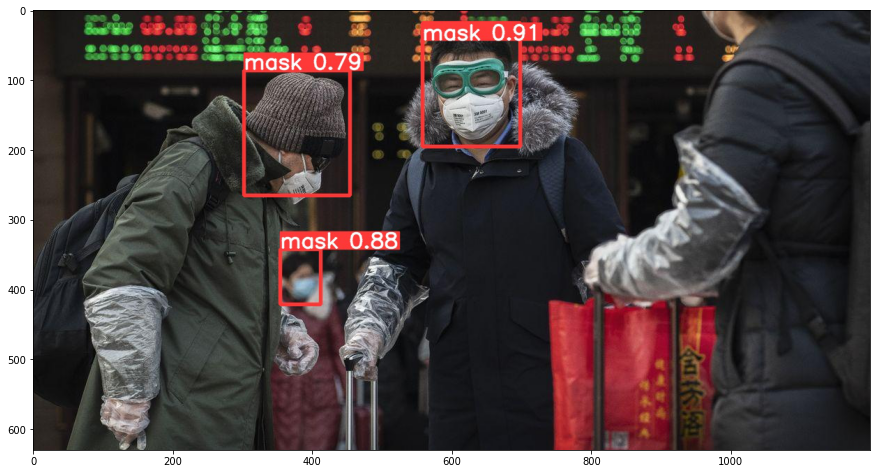

In [ ]:
plt.figure(figsize=(15,20))
img = Image.open("/content/yolov5/runs/detect/exp/test.jpg")
plt.imshow(img)
plt.show()

In [ ]:
! python detect.py --source "https://www.youtube.com/watch?v=hekZBf8oUq0" --weights "/content/yolov5/runs/train/exp/weights/best.pt"

Streaming output truncated to the last 5000 lines.
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.007s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 1 no_mask, Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.007s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.006s)
0: 384x640 Done. (0.010s)
0: 